In [1]:
import sys
sys.path.append("../")

In [8]:
import scipy
from post_processing.src import hdf5_tools
from post_processing.src import plotting
from post_processing.src import filter_joints
import matplotlib.pyplot as plt
import numpy as np
import multiprocessing
from platform import python_version
import h5py
import pathlib
import pandas as pd

from post_processing.src import hdf5_tools


%matplotlib inline 

In [11]:
target_dir=pathlib.Path("/media/mjsobrep/43CDA61E672B9161/pose/")
hdf5_file = h5py.File(target_dir/"smoothed_data.hdf5",'r')
train=pd.read_csv(target_dir/"train.csv")

In [12]:
train

,Unnamed: 0,Unnamed: 0.1,record_id,age,bbt.z_left,bbt.z_right,min_bbt
0,9,10,23,4,-1.034091,-2.561644,-2.561644
1,25,26,44,7,-3.071429,-10.169811,-10.169811
2,3,4,15,5,0.396552,0.507463,0.396552
3,27,28,46,18,-3.764706,-3.712766,-3.764706
4,28,29,48,15,-9.443038,-5.241379,-9.443038
5,36,37,63,14,-5.139241,-4.781609,-5.139241
6,24,25,43,14,-3.367089,-2.942529,-3.367089
7,29,30,49,16,-2.670330,-2.333333,-2.670330
8,37,38,64,13,-2.365854,-2.481928,-2.481928
9,1,2,13,62,-2.654321,-4.806818,-4.806818


In [4]:
hdf5_tools.print_members(hdf5_file)    

003
003/simon_says
003/simon_says/0
003/simon_says/0/time
004
004/simon_says
004/simon_says/0
004/simon_says/0/filtered
004/simon_says/0/filtered/LElbow
004/simon_says/0/filtered/LShoulder
004/simon_says/0/filtered/LWrist
004/simon_says/0/filtered/RElbow
004/simon_says/0/filtered/RShoulder
004/simon_says/0/filtered/RWrist
004/simon_says/0/raw
004/simon_says/0/raw/LElbow
004/simon_says/0/raw/LShoulder
004/simon_says/0/raw/LWrist
004/simon_says/0/raw/RElbow
004/simon_says/0/raw/RShoulder
004/simon_says/0/raw/RWrist
004/simon_says/0/smooth
004/simon_says/0/smooth/LElbow
004/simon_says/0/smooth/LShoulder
004/simon_says/0/smooth/LWrist
004/simon_says/0/smooth/RElbow
004/simon_says/0/smooth/RShoulder
004/simon_says/0/smooth/RWrist
004/simon_says/0/time
006
006/simon_says
006/simon_says/0
006/simon_says/0/filtered
006/simon_says/0/filtered/LElbow
006/simon_says/0/filtered/LShoulder
006/simon_says/0/filtered/LWrist
006/simon_says/0/filtered/RElbow
006/simon_says/0/filtered/RShoulder
006/simon_

048/simon_says/0/raw/RShoulder
048/simon_says/0/raw/RWrist
048/simon_says/0/smooth
048/simon_says/0/smooth/LElbow
048/simon_says/0/smooth/LShoulder
048/simon_says/0/smooth/LWrist
048/simon_says/0/smooth/RElbow
048/simon_says/0/smooth/RShoulder
048/simon_says/0/smooth/RWrist
048/simon_says/0/time
048/simon_says/1
048/simon_says/1/filtered
048/simon_says/1/filtered/LElbow
048/simon_says/1/filtered/LShoulder
048/simon_says/1/filtered/LWrist
048/simon_says/1/filtered/RElbow
048/simon_says/1/filtered/RShoulder
048/simon_says/1/filtered/RWrist
048/simon_says/1/raw
048/simon_says/1/raw/LElbow
048/simon_says/1/raw/LShoulder
048/simon_says/1/raw/LWrist
048/simon_says/1/raw/RElbow
048/simon_says/1/raw/RShoulder
048/simon_says/1/raw/RWrist
048/simon_says/1/smooth
048/simon_says/1/smooth/LElbow
048/simon_says/1/smooth/LShoulder
048/simon_says/1/smooth/LWrist
048/simon_says/1/smooth/RElbow
048/simon_says/1/smooth/RShoulder
048/simon_says/1/smooth/RWrist
048/simon_says/1/time
049
049/simon_says
049/

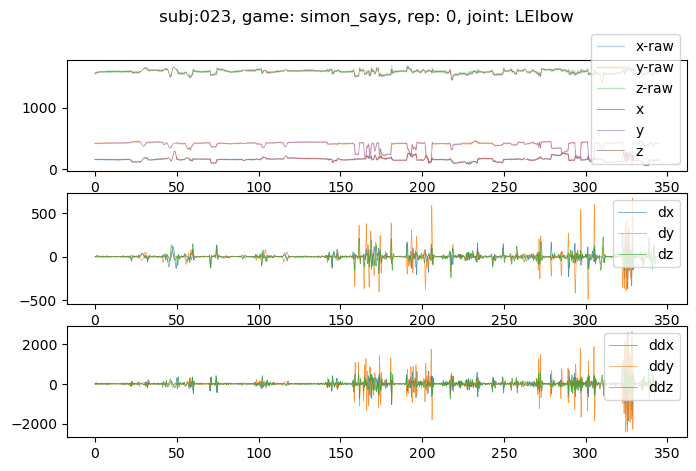

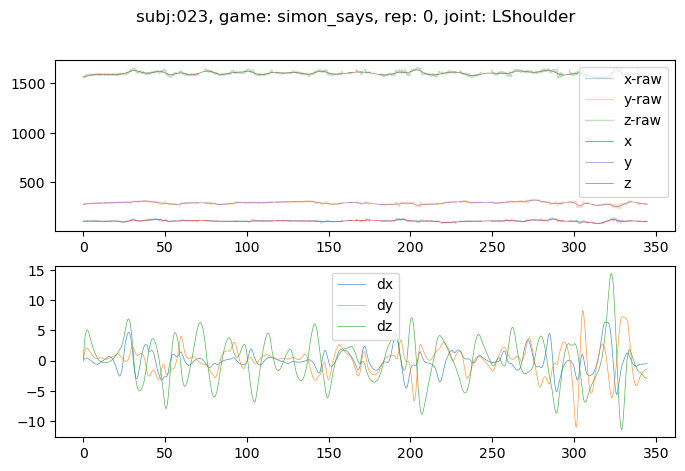

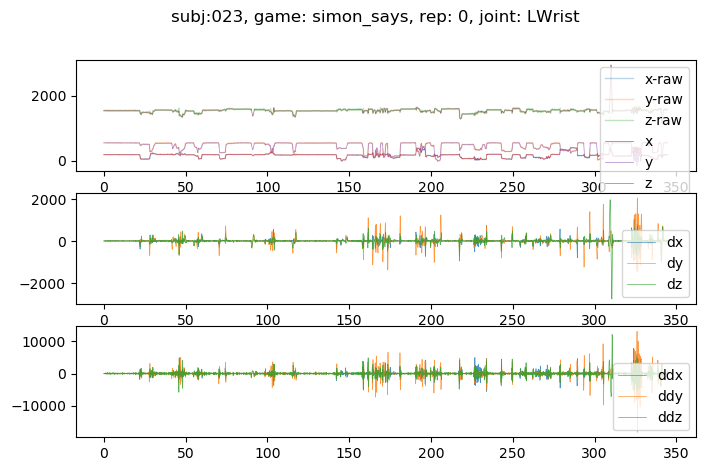

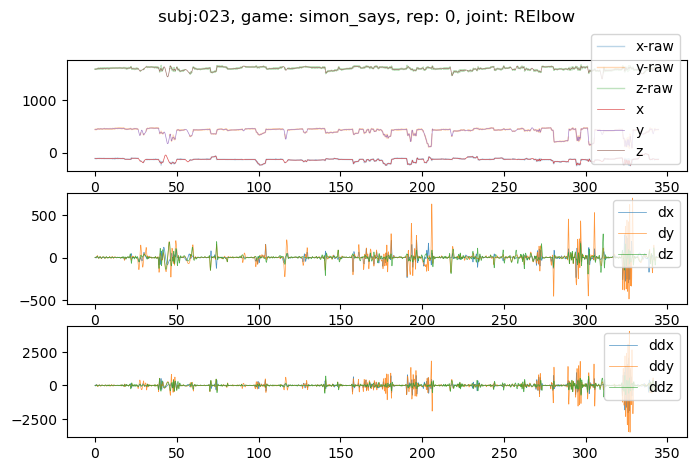

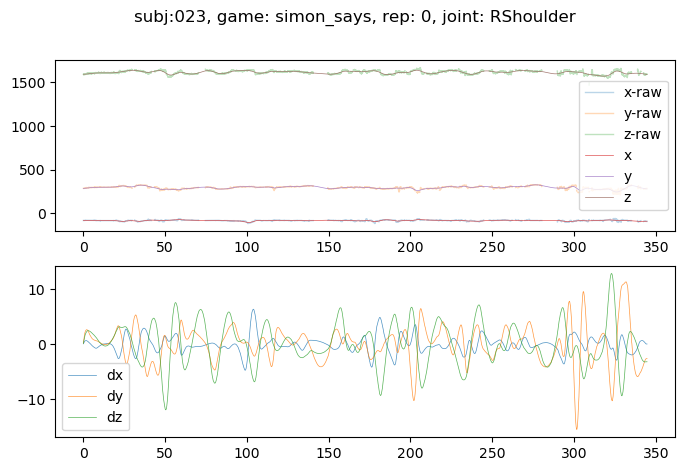

...

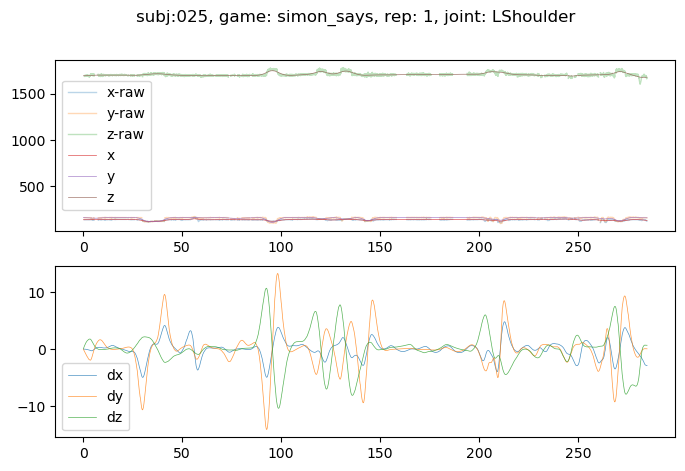

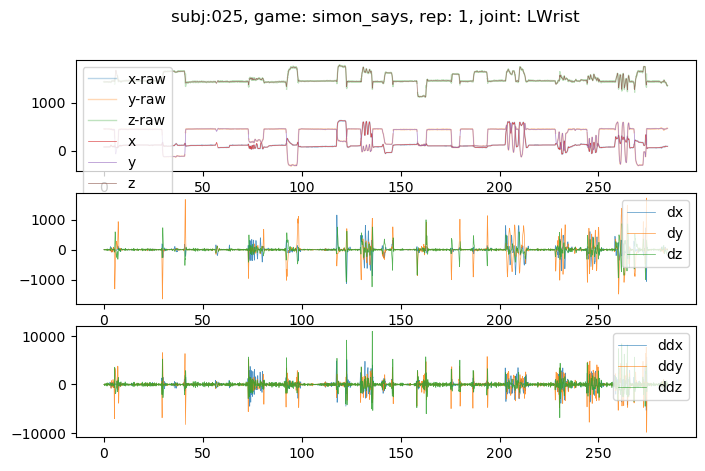

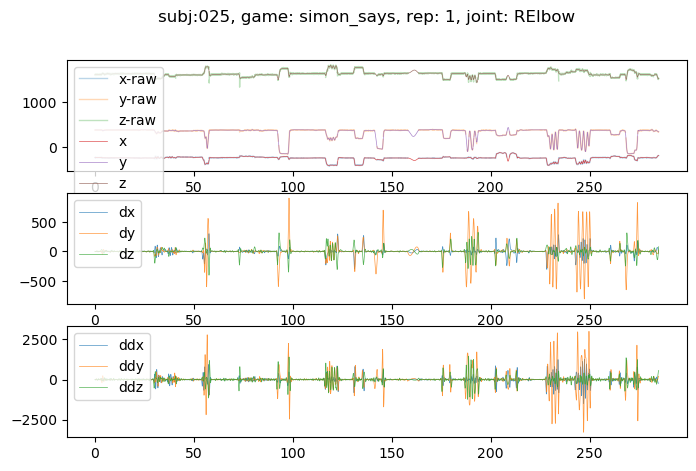

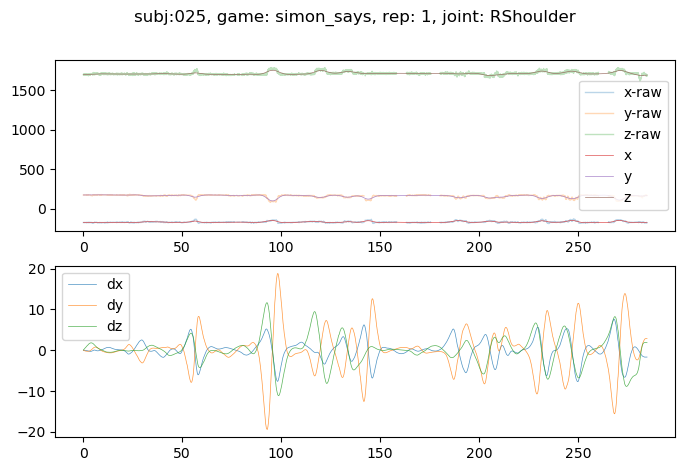

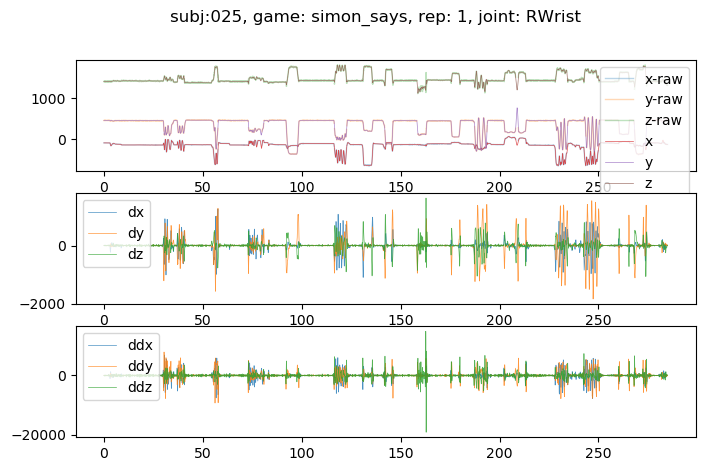

In [14]:
for subj in [f'0{id}' for id in train['record_id']]:
    for game_name in hdf5_file[subj]:
        games=hdf5_file[subj][game_name]
        for rep in games:
            game_rep=games[rep]
            if 'smooth' in game_rep:
                for joint in game_rep['smooth']:
                    plotting.plot_model_results(game_rep['time'], game_rep['raw'][joint], game_rep['smooth'][joint], title=f'subj:{subj}, game: {game_name}, rep: {rep}, joint: {joint}')
                    plt.show()

In [6]:
hdf5_file[subj][game][game_rep].keys()

NameError: name 'game' is not defined